# Pre-Processing Ames Housing Data

### Contents

 - I.  [Barebones Processing (Control Dataset)](#Barebones-Processing-(Control-Dataset))
 - II. [Feature Engineering](#Feature-Engineering)
     - [Generating New Features](#Generating-New-Features)
     - [Consolidating Redundant Features](#Consolidating-Redundant-Features)
     - [Quantitative Data Imputation](#Quantitative-Data-Imputation)
 - III. [Filtering Noisy Classes Within Features](#Filtering-Noisy-Classes-Within-Features)
     - [Creating a Frequency Filter for Dummification](#Creating-a-Frequency-Filter-for-Dummification)
     - [Dummification of Remaining Nominal Features](#Dummification-of-Remaining-Nominal-Features)
 - IV. [Ordinal Data Processing](#Ordinal-Data-Processing)
     - [Ordinal Feature Dummification](#Ordinal-Feature-Dummification)
     - [Ordinal Encoding through SciKitLearn's Ordinal Encoder](#Ordinal-Encoding-through-SciKitLearn's-Ordinal-Encoder)
 - V.  [Filtering Observations using Cook's Distance Outliers](#Filtering-Observations-using-Cook's-Distance-Outliers)
     - [Cook's Distance filtering process for Ordinal Dummification Dataset](#Cook's-Distance-filtering-process-for-Ordinal-Dummification-Dataset)
     - [Cook's Distance filtering process for Ordinal Encoding Dataset](#Cook's-Distance-Outlier-process-for-Ordinal-Encoding-Dataset)
 - VI. [Six ML-Ready Datasets](#Six-ML-Ready-Datasets)

Importing Training Dataset and initial packages

In [1]:
import numpy as np
import pandas as pd
ames = pd.read_csv('ames_train.csv').set_index('Id')
pd.options.display.max_columns = None
ames.head(20)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900


## Barebones Processing (Control Dataset)
[Back to Top](#Pre-Processing-Ames-Housing-Data)

I wanted a dataset with just the bare minimum done to make it Machine Learning ready. By comparing the $R^{2}$ from this barebones treatment to datasets I build below, I can see the impact of the many feature and observation refinements in this preprocessing document. The most basic way to make a ML-capable dataset is to:
- Eliminate any NA's from the numerical (quantitative) features 
    - Here I impute the NA's to the median value of the feature
- Dummification of all catergorical (qualitative) features 
    - Here I use 'drop_first=True' to avoid redundancy of dummifying every feature

In [ ]:
ames_quant = ames.copy().select_dtypes(include = np.number)
for col in ames_quant.columns:
    ames_quant[col].fillna(round(np.median(ames_quant[col][~ames_quant[col].isna()])), inplace=True)
np.sum(np.sum(ames_quant.isna())) # There should be no NA observations in dataset

In [ ]:
ames_qual = ames.copy().select_dtypes(exclude = np.number)
ames_qual_dummies = pd.DataFrame([])
for col in ames_qual.columns:
    ames_qual_dummies_list = pd.get_dummies(list(ames_qual[col]), prefix=col, prefix_sep='', drop_first=True) 
    ames_qual_dummies = pd.concat([ames_qual_dummies, ames_qual_dummies_list], axis=1)
ames_qual_dummies.index = ames_qual_dummies.index + 1

ames_barebones = pd.concat([ames_quant, ames_qual_dummies], axis=1)
ames_barebones.select_dtypes(exclude = np.number).columns

In [ ]:
ames_barebones.to_csv('ames_barebones.csv', header=True)

# Feature Engineering
[Back to Top](#Pre-Processing-Ames-Housing-Data)

## Generating New Features 

### Creating New Age-Related Features 
* Was the house remodeled?
* How old is the house?
* How long since the house was last remodeled? (If never remodeled, will be the same year it was built)
* How old is the garage?

In [2]:
ames['Remodeled'] = np.where(ames['YearRemodAdd'] == ames['YearBuilt'], 0, 1)
ames['AgeSinceBuilt'] = ames['YrSold'] - ames['YearBuilt']
ames['AgeSinceRemodeled'] = ames['YrSold'] - ames['YearRemodAdd']
ames['GarageAge'] = ames['YrSold'] - ames['GarageYrBlt']

### Turning MiscFeature / MiscVal an into separate features with square footage values
- Creating new features to show the square footage of a Shed or 2nd Garage on the property
- Adding 2nd Garage sq ft to existing Gararge Area feature, ensuring all Garage Area is included.
- Dropping remaining features (other, Tennis Court, and 2nd Garage now that it is merged with Garage Area)

In [3]:
ames.MiscFeature.value_counts()

Shed    49
Othr     2
Gar2     2
TenC     1
Name: MiscFeature, dtype: int64

In [4]:
ames['Shed'] = np.where(ames['MiscFeature'] == 'Shed', ames['MiscVal'], 0)
ames['Gar2'] = np.where(ames['MiscFeature'] == 'Gar2', ames['MiscVal'], 0)
ames['GarageArea'] = ames['Gar2'] + ames['GarageArea']
ames.drop(['MiscFeature', 'MiscVal', 'Gar2'], axis=1, inplace=True)

### Replacing binary-choice features with 1 and 0 (3 different methods)
- METHOD 1: Replacing within existing feature using replace function
- METHOD 2: Replacing by creating a new feature using replace function 
- METHOD 3: Replacing using dummification (get_dummies)

In [5]:
ames['CentralAir'].replace(['Y','N'], [1,0], inplace=True)

ames['PavedStreet'] = ames['Street'].replace(['Pave','Grvl'], [1,0])
ames.drop(['Street'], axis=1, inplace=True)

ames_alley = pd.get_dummies(list(ames['Alley']), prefix='Alley', prefix_sep='') 
ames_alley.index = ames_alley.index + 1
ames = pd.concat([ames, ames_alley], axis=1)
ames.drop(['Alley'], axis=1, inplace=True)

### Creating Compiled Size / Square Footage Features from smaller data points
- Percentage of the Basement that is Finished
- Total Number of Half Baths in entire house (basement and above grade)
- Total Number of Full Baths in entire house (basement and above grade)
- Total Number of Baths in basement
- Total Number of Baths above grade
- Total Number of Baths in entire house (basement and above grade)
- Total Deck Space (Decks, Porches)
- Total Living Area (basement and above grade)
- Total Finished Living Area (finished basement and above grade)
- Total Garage / Shed Space
- Total Foundation Area
- Total Outdoor Area
- Total Square Footage of all levels on property (all indoor floors including basement, outdoor space, garage/shed space)

In [6]:
ames['BsmtPercFin'] = 0
ames.loc[ames.TotalBsmtSF!=0, 'BsmtPercFin'] = 100 * (ames.TotalBsmtSF - ames.BsmtUnfSF) / ames.TotalBsmtSF
ames['TotalHalfBath'] = ames.BsmtHalfBath + ames.HalfBath
ames['TotalFullBath'] = ames.BsmtFullBath + ames.FullBath
ames['BsmtTotalBath'] = 0.5 * ames.BsmtHalfBath + ames.BsmtFullBath
ames['GrTotalBath'] = 0.5 * ames.HalfBath + ames.FullBath
ames['TotalBath'] = ames.BsmtTotalBath + ames.GrTotalBath
ames['TotalDeckSpace'] = ames.WoodDeckSF + ames.OpenPorchSF + ames.EnclosedPorch + ames['3SsnPorch'] + ames.ScreenPorch
ames['TotalLivingArea'] = ames.GrLivArea + ames.TotalBsmtSF
ames['TotalFinLivingArea'] = ames.TotalLivingArea - ames.BsmtUnfSF
ames['TotalGarageShed'] = ames.GarageArea + ames.Shed
ames['FoundationArea'] = ames['1stFlrSF'] + ames.TotalGarageShed
ames['TotalOutdoorSF'] = ames.LotArea - ames.FoundationArea
ames['TotalSF'] = ames.TotalLivingArea + ames.TotalOutdoorSF + ames.TotalGarageShed

## Consolidating Redundant Features
### Consolidating MSSubClass, BldgType and HouseStyle redundant property descriptions
#### Many of these categories overlap when looking at the key for the MSSubClass categories.
MSSubClass: Identifies the type of dwelling involved in the sale.	

        20	1-STORY 1946 & NEWER ALL STYLES
        30	1-STORY 1945 & OLDER
        40	1-STORY W/FINISHED ATTIC ALL AGES
        45	1-1/2 STORY - UNFINISHED ALL AGES
        50	1-1/2 STORY FINISHED ALL AGES
        60	2-STORY 1946 & NEWER
        70	2-STORY 1945 & OLDER
        75	2-1/2 STORY ALL AGES
        80	SPLIT OR MULTI-LEVEL
        85	SPLIT FOYER
        90	DUPLEX - ALL STYLES AND AGES
       120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
       150	1-1/2 STORY PUD - ALL AGES
       160	2-STORY PUD - 1946 & NEWER
       180	PUD - MULTILEVEL - INCL SPLIT LEV/FOYER
       190	2 FAMILY CONVERSION - ALL STYLES AND AGES
     
BldgType: Type of dwelling
		
       1Fam	  Single-family Detached	
       2FmCon	Two-family Conversion; originally built as one-family dwelling
       Duplx	 Duplex
       TwnhsE	Townhouse End Unit
       TwnhsI	Townhouse Inside Unit
	
HouseStyle: Style of dwelling
	
       1Story	One story
       1.5Fin	One and one-half story: 2nd level finished
       1.5Unf	One and one-half story: 2nd level unfinished
       2Story	Two story
       2.5Fin	Two and one-half story: 2nd level finished
       2.5Unf	Two and one-half story: 2nd level unfinished
       SFoyer	Split Foyer
       SLvl	  Split Level

Since there can only be one house value per feature, some houses are listed two different ways depending on which feature one looks at. 
In order to make sure no descriptive data about a house would be lost, I created new features that would capture that data, regardless of where it was presented in the original data. These new features would then replace the original MSSubClass, BldgType, and HouseStyle features.
Finally, I eliminated the distinction of '1945 & OLDER' versus '1946 & NEWER' in the MSSubClass feature. While an important year for the world, 1945 is an arbitrary year in terms of housing to distinguish different types of houses, and age data is represented elsewhere in the dataset.
NEW CONSOLIDATED FEATURES:
- 1.5 Story House (finished or unfinished 2nd level)
- 2.5 Story House (finished or unfinished 2nd level)
- 1 Story House (any age)
- 2 Story House (any age)
- Split House of Any Type
- Split Level
- Split Foyer
- Shared House of Any Type (Duplex, 2-Family Conversion)
- Duplex
- 2-Family Conversion
- Townhouse (any type)
- Interior Townhouse (2 neighboring townhouses)
- End Townhouse (1 neighboring townhouse)
- 1-Family Unit (of any type)
- Planned Unit Development (PUD) of any size

In [7]:
ames['Class1hfStr'] = np.where(((ames['HouseStyle'] == "1.5Fin") | (ames['HouseStyle'] == "1.5Unf") | (ames['MSSubClass'] == 45) | (ames['MSSubClass'] == 50)), 1, 0)
ames['Class2hfStr'] = np.where(((ames['HouseStyle'] == "2.5Fin") | (ames['HouseStyle'] == "2.5Unf") | (ames['MSSubClass'] == 75)), 1, 0)
ames['Class1Str'] = 0
ames['Class1Str'] = np.where((((ames['HouseStyle'] == "1Story") | (ames['MSSubClass'] == 20) | (ames['MSSubClass'] == 30) | (ames['MSSubClass'] == 40) | (ames['MSSubClass'] == 120)) & (ames['Class1hfStr'] != 1)), 1, 0)
ames['Class2Str'] = 0
ames['Class2Str'] = np.where(((ames['HouseStyle'] == "2Story") | (ames['MSSubClass'] == 60) | (ames['MSSubClass'] == 70) | (ames['MSSubClass'] == 160))  & (ames['Class2hfStr'] != 1), 1, 0)
ames['ClassSplit'] = np.where(((ames['HouseStyle'] == "SLvl") | (ames['HouseStyle'] == "SFoyer") | (ames['MSSubClass'] == 80) | (ames['MSSubClass'] == 85) | (ames['MSSubClass'] == 180)), 1, 0)
ames['ClassSLvl'] = np.where(((ames['HouseStyle'] == "SLvl") | (ames['MSSubClass'] == 80)), 1, 0)
ames['ClassSFoyer'] = np.where(((ames['HouseStyle'] == "SFoyer") | (ames['MSSubClass'] == 85)), 1, 0)
ames['ClassShared'] = np.where(((ames['BldgType'] == "Duplex") | (ames['BldgType'] == "2fmCon") | (ames['MSSubClass'] == 90) | (ames['MSSubClass'] == 190)), 1, 0)
ames['ClassDuplex'] = np.where((ames['BldgType'] == "Duplex"), 1, 0)
ames['Class2fmCon'] = np.where(((ames['BldgType'] == "2fmCon") | (ames['MSSubClass'] == 190)), 1, 0)
ames['ClassTwnhs'] = np.where(((ames['BldgType'] == "Twnhs") | (ames['BldgType'] == "TwnhsE")), 1, 0)
ames['ClassTwnhsI'] = np.where((ames['BldgType'] == "Twnhs"), 1, 0)
ames['ClassTwnhsE'] = np.where((ames['BldgType'] == "TwnhsE"), 1, 0)
ames['Class1Fam'] = np.where((ames['BldgType'] == "1Fam"), 1, 0)
ames['PUD'] = np.where(((ames['MSSubClass'] == 120) | (ames['MSSubClass'] == 160) | (ames['MSSubClass'] == 180)), 1, 0)

ames.drop(['MSSubClass','BldgType','HouseStyle'], axis=1, inplace=True)
ames

,MSZoning,LotFrontage,LotArea,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice,Remodeled,AgeSinceBuilt,AgeSinceRemodeled,GarageAge,Shed,PavedStreet,AlleyGrvl,AlleyPave,BsmtPercFin,TotalHalfBath,TotalFullBath,BsmtTotalBath,GrTotalBath,TotalBath,TotalDeckSpace,TotalLivingArea,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class2hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassSFoyer,ClassShared,ClassDuplex,Class2fmCon,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD
1,RL,65.0,8450,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,1,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,2,2008,WD,Normal,208500,0,5,5,5.0,0,1,0,0,82.476636,1,3,1.0,2.5,3.5,61,2566,2416,548,1404,7046,10160,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
2,RL,80.0,9600,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,1,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,5,2007,WD,Normal,181500,0,31,31,31.0,0,1,0,0,77.496038,1,2,0.5,2.0,2.5,298,2524,2240,460,1722,7878,10862,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
3,RL,68.0,11250,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,1,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,9,2008,WD,Normal,223500,1,7,6,7.0,0,1,0,0,52.826087,1,3,1.0,2.5,3.5,42,2706,2272,608,1528,9722,13036,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
4,RL,60.0,9550,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,1,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,2,2006,WD,Abnorml,140000,1,91,36,8.0,0,1,0,0,28.571429,0,2,1.0,1.0,2.0,307,2473,1933,642,1603,7947,11062,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
5,RL,84.0,14260,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,1,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,12,2008,WD,Normal,250000,0,8,8,8.0,0,1,0,0,57.205240,1,3,1.0,2.5,3.5,276,3343,2853,836,1981,12279,16458,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1456,RL,62.0,7917,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,953,GasA,Ex,1,SBrkr,953,694,0,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,0,0,0,0,NaN,NaN,8,2007,WD,Normal,175000,1,8,7,8.0,0,1,0,0,0.000000,1,2,0.0,2

### Consolidating where information can appear in either of 2 paired features (Feature1 / Feature2)
#### The issue that is present in the data is that both paired features have the same class choices, but the same class could be listed in Feature1 for one property and in Feature2 for a different property. If one simply dummified these paired features, there would be multiple new binary features created conveying identical information, as each feature's identical class would be dummified. As such, I needed to create my own dummified features by using np.where conditions to show if a class common to both Feature1 and Feature2 appeared in either feature.
Here I created new Proximity features combining 'Condition1' and 'Condition2' lists (Proximity to Various Conditions). As there are 9 possible classes, I created a for loop in order to generate dummified features for each of the possible Proximity classes.

In [8]:
proxlist = list(ames.Condition1.unique()[1:9])
proxname = list("Prox" + ames.Condition1.unique()[1:9])
for idx in range(0,8):
    ames[proxname[idx]] = np.where(((ames['Condition1'] == proxlist[idx]) | (ames['Condition2'] == proxlist[idx])), 1, 0)
ames.drop(['Condition1','Condition2'], axis=1, inplace=True)

Before doing the same procedure for the paired features detailing the Exterior covering on the House, I had to do some data cleaning. There were 2 class typos that created mismatches between the features, 2 classes where I had to eliminate a space before dummifying, and 1 consolidation of Brick Common and Brick Face. I also eliminated any classes that had very low sample size ('AsphShn', 'CBlock', 'ImStucc', 'Stone', 'Other') by turning their classes into NaN's that would be ignored in the dummification.

In [9]:
ames['Exterior1st'].value_counts().sort_index()

AsbShng     20
AsphShn      1
BrkComm      2
BrkFace     50
CBlock       1
CemntBd     61
HdBoard    222
ImStucc      1
MetalSd    220
Plywood    108
Stone        2
Stucco      25
VinylSd    515
Wd Sdng    206
WdShing     26
Name: Exterior1st, dtype: int64

In [10]:
ames['Exterior2nd'].value_counts().sort_index()

AsbShng     20
AsphShn      3
Brk Cmn      7
BrkFace     25
CBlock       1
CmentBd     60
HdBoard    207
ImStucc     10
MetalSd    214
Other        1
Plywood    142
Stone        5
Stucco      26
VinylSd    504
Wd Sdng    197
Wd Shng     38
Name: Exterior2nd, dtype: int64

In [11]:
ames['Exterior1st'].replace(['Wd Sdng','CemntBd','BrkComm','AsphShn','CBlock','ImStucc','Stone'],\
                            ['WdSdng','CmentBd','BrkFace',np.nan, np.nan, np.nan, np.nan], inplace=True)
ames['Exterior2nd'].replace(['Wd Sdng','Wd Shng','Brk Cmn','AsphShn','CBlock','ImStucc','Stone','Other'],\
                            ['WdSdng','WdShing','BrkFace',np.nan, np.nan, np.nan, np.nan, np.nan], inplace=True)

With these discrepancies treated and low-sample classes removed from the 'Exterior1st' and 'Exterior2nd' features, I then created a for loop in order to generate dummified features for each of the possible Exterior Covering classes.

In [12]:
exteriorlist = list(ames.Exterior1st.unique()[0:10])
exteriorname = list("Ext" + ames.Exterior1st.unique()[0:10])
for idx in range(0,len(exteriorlist)):
    ames[exteriorname[idx]] = np.where(((ames['Exterior1st'] == exteriorlist[idx]) | (ames['Exterior2nd'] == exteriorlist[idx])), 1, 0)
ames.drop(['Exterior1st','Exterior2nd'], axis=1, inplace=True)

### Combining Class Type with Square Footage in New Quantitative Features
Here I created new Features from each major class of Masonry Veneer Type 'MasVnrType' using values from paired Masonry Veneer Area 'MasVnrArea' square footage feature. I also consolidated the two types of Brick Veneer, as Brick Common 'BrkCmn' alone has too low of a sample size to be much beyond noise if given its own feature.

In [13]:
ames['MasVnrType'].value_counts() 

None       864
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64

In [14]:
ames['MasVnrBrkFace'] = np.where(((ames['MasVnrType'] == 'BrkFace') | (ames['MasVnrType'] == 'BrkCmn')), ames['MasVnrArea'], 0)
ames['MasVnrStone'] = np.where(ames['MasVnrType'] == 'Stone', ames['MasVnrArea'], 0)
ames.drop(['MasVnrType','MasVnrArea'], axis=1, inplace=True)

### Consolidating Similar Class Types
GarageType values: Basement Garages are just a below-grade variant of a Built-in Garage

In [15]:
ames['GarageType'].value_counts() 

Attchd     870
Detchd     387
BuiltIn     88
Basment     19
CarPort      9
2Types       6
Name: GarageType, dtype: int64

In [16]:
ames['GarageType'].replace('Basment','BuiltIn', inplace=True)

Electrical values: Fuse Types can be consolidated

In [17]:
ames['Electrical'].value_counts() 

SBrkr    1334
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64

In [18]:
ames['Electrical'].replace(['FuseA', 'FuseF', 'FuseP'],'Fuse', inplace=True)

### Checking on all of the newly created / consolidated features

In [19]:
ames.iloc[:,-40:-1]

,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class2hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassSFoyer,ClassShared,ClassDuplex,Class2fmCon,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD,ProxFeedr,ProxPosN,ProxArtery,ProxRRAe,ProxRRNn,ProxRRAn,ProxPosA,ProxRRNe,ExtVinylSd,ExtMetalSd,ExtWdSdng,ExtHdBoard,ExtBrkFace,ExtWdShing,ExtCmentBd,ExtPlywood,ExtAsbShng,ExtStucco,MasVnrBrkFace
1,2416,548,1404,7046,10160,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,196.0
2,2240,460,1722,7878,10862,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0.0
3,2272,608,1528,9722,13036,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,162.0
4,1933,642,1603,7947,11062,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0.0
5,2853,836,1981,12279,16458,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,350.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1456,1647,460,1413,6504,9564,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0.0
1457,3026,500,2573,10602,14717,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0.0
1458,2615,2752,3940,5102,11346,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0.0
1459,2156,240,1318,8399,10795,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0.0


## Quantitative Data Imputation 
Checking which quantitative features have NA's or missing values remaining, and then filling them with median value or 0.

In [20]:
pd.options.display.max_rows = None
nas_values = np.sum(ames.select_dtypes(include = np.number).isna()).sort_values(ascending=False)
nas_values[nas_values != 0]

LotFrontage    259
GarageAge       81
GarageYrBlt     81
dtype: int64

Using the median for age-related imputation (GarageYrBlt, GarageAge) will make imputed values less likely to impact the model  
Using 0 for size-based imputation (LotFrontage) makes sense, as a house is unlikely to have any frontage if not noted in the original data

In [21]:
ames.GarageYrBlt.fillna(round(np.median(ames.GarageYrBlt[~ames.GarageYrBlt.isna()])), inplace=True)
ames.GarageAge.fillna(round(np.median(ames.GarageAge[~ames.GarageAge.isna()])), inplace=True)
ames.LotFrontage.fillna(0, inplace=True)

Writing pre-processing so far to a .csv file

In [22]:
ames.to_csv('ames_pre_processed.csv', header=True)

# Filtering Noisy Classes Within Features
[Back to Top](#Pre-Processing-Ames-Housing-Data)

## Creating a Frequency Filter for Dummification

- Dummification doesn't care if there are 1000 or 10 observations, but it is rare to draw meaningful conclusions from a tiny number of observations (or a lack of alternative observations), and these classes will likely contribute more noise than insights.  
- As I needed a number that did not feel arbitrary, I decided to filter classes with fewer than 38 observations, which is the rounded square root of the total number of training set observations (1460).  
- In addition, a feature that is observed in 1453 of the 1460 houses is not useful to generate insights either, as there are not enough alternative observations without said feature to draw a conclusion as well.  
- Thus I created a low filter of <38 ('ameslowfilter') and a high filter of >1422, which is 1460-38 ('ameshighfilter').

In [23]:
ameslowfilter = round(np.sqrt(len(ames)))
ameshighfilter = len(ames) - ameslowfilter

To filter classes within these nominal categorical features, I created a for loop that would:
- Replace any NA's with 'None', so that NA data would not be lost in the dummification process
- Go through each qualitative feature's classes and replace any classes with too low or too high frequencies with NA. 
  - These new NA's would not be dummified, effectively filtering them out and only leaving new dummified features with a meaningful sample size
- Create Dictionaries to record which:
  - Classes of each nominal feature were *dummified* (ames_nom_remain_dict)
  - Classes of each nominal feature that were *dropped* (ames_nom_drop_dict)
  - Any nominal features where no classes were dropped (ames_nom_none_dict)
    - This is important, as the dummification is not using the 'drop_first = True' argument
    - Therefore, any features with no dropped classes by frequency filter must have a class manually dropped as to not have a redundant new feature created

In [24]:
# Generating a list of all nominal features
nominal_list = ['MSZoning', 'LotConfig', 'Neighborhood', 'RoofStyle', 'RoofMatl', 'Foundation', 'Heating', 'Electrical', 'GarageType', 'PavedDrive', 'SaleType', 'SaleCondition']

ames_nom_remain_dict = {}
ames_nom_drop_dict = {}
ames_nom_none_dict = {}
ames_nom_none_list = []

for nom in nominal_list:
    ames[nom].fillna('None', inplace=True)
    valuetest = ames[nom].value_counts()
    valuefilter = valuetest[(valuetest < ameslowfilter) | (valuetest > ameshighfilter)]
    valuelist = valuefilter.index.to_list()
    nanlist = [np.nan] * len(valuelist)
    ames[nom].replace(valuelist, nanlist, inplace=True)
    
    remain_dict = {}
    remainfilter = valuetest[(valuetest >= ameslowfilter) & (valuetest <= ameshighfilter)]
    for idx in range(0,len(remainfilter)):
        remain_dict[remainfilter.index[idx]] = remainfilter[idx]
    ames_nom_remain_dict[nom] = remain_dict
    
    remove_dict = {}
    for idx in range(0,len(valuefilter)):
        remove_dict[valuefilter.index[idx]] = valuefilter[idx]
    ames_nom_drop_dict[nom] = remove_dict
    
    none_dict = {}
    if len(valuefilter)==0:
        ames_nom_none_list.append(str(nom + remainfilter.index[len(remainfilter) - 1]))
        none_dict[remainfilter.index[len(remainfilter) - 1]] = remainfilter[len(remainfilter) - 1]
        ames_nom_none_dict[nom] = none_dict

# Check to see if there are any classes we will have to manually drop prior to dummification
ames_nom_none_dict

{}

Since there were no nominal features with no classes removed by the frequency filter, we do not need to manually remove any excess classes since at least one class was dropped from each feature.

## Dummification of Remaining Nominal Features
When using dummification, it is easiest to leave out one feature on which to concat the newly dummified features back onto.   
As such, I left the 'Fence' feature separated and manually dummified the feature, including dropping the class that would have been filtered by the frequency filter employed above. I also created a larger binary feature on whether or not there was any fence present on the property.

Finally I dummified the nominal features and re-attached it to the Fence features, and then to the larger Ames dataset, dropping any original features that were dummified.

In [25]:
ames_nom_dummies = pd.get_dummies(list(ames['Fence']), prefix='Fence', prefix_sep='')
ames_nom_dummies['Fence'] = ames_nom_dummies.FenceGdPrv + ames_nom_dummies.FenceMnPrv + ames_nom_dummies.FenceGdWo + ames_nom_dummies.FenceMnWw
ames_nom_dummies.drop(['FenceMnWw'], axis=1, inplace=True)

for idx in range(0, len(nominal_list)):
    ames_nom_dummies_list = pd.get_dummies(list(ames[nominal_list[idx]]), prefix=nominal_list[idx], prefix_sep='', drop_first=False) 
    ames_nom_dummies = pd.concat([ames_nom_dummies, ames_nom_dummies_list], axis=1)
ames_nom_dummies.index = ames_nom_dummies.index + 1

ames.drop(['Fence'], axis=1, inplace=True)
ames.drop(nominal_list, axis=1, inplace=True)
ames = pd.concat([ames, ames_nom_dummies], axis=1)

#### Checking the dictionaries created in the for loop above to see which classes in nominal features were kept and which were dropped
Classes within nominal features that were kept and dummified (with observation count)

In [26]:
ames_nom_remain_dict

{'MSZoning': {'RL': 1151, 'RM': 218, 'FV': 65},
 'LotConfig': {'Inside': 1052, 'Corner': 263, 'CulDSac': 94, 'FR2': 47},
 'Neighborhood': {'NAmes': 225,
  'CollgCr': 150,
  'OldTown': 113,
  'Edwards': 100,
  'Somerst': 86,
  'Gilbert': 79,
  'NridgHt': 77,
  'Sawyer': 74,
  'NWAmes': 73,
  'SawyerW': 59,
  'BrkSide': 58,
  'Crawfor': 51,
  'Mitchel': 49,
  'NoRidge': 41,
  'Timber': 38},
 'RoofStyle': {'Gable': 1141, 'Hip': 286},
 'RoofMatl': {},
 'Foundation': {'PConc': 647, 'CBlock': 634, 'BrkTil': 146},
 'Heating': {},
 'Electrical': {'SBrkr': 1334, 'Fuse': 124},
 'GarageType': {'Attchd': 870, 'Detchd': 387, 'BuiltIn': 107, 'None': 81},
 'PavedDrive': {'Y': 1340, 'N': 90},
 'SaleType': {'WD': 1267, 'New': 122, 'COD': 43},
 'SaleCondition': {'Normal': 1198, 'Partial': 125, 'Abnorml': 101}}

Classes within nominal features that were filtered out and not dummified (with observation count)

In [27]:
ames_nom_drop_dict

{'MSZoning': {'RH': 16, 'C (all)': 10},
 'LotConfig': {'FR3': 4},
 'Neighborhood': {'IDOTRR': 37,
  'ClearCr': 28,
  'SWISU': 25,
  'StoneBr': 25,
  'MeadowV': 17,
  'Blmngtn': 17,
  'BrDale': 16,
  'Veenker': 11,
  'NPkVill': 9,
  'Blueste': 2},
 'RoofStyle': {'Flat': 13, 'Gambrel': 11, 'Mansard': 7, 'Shed': 2},
 'RoofMatl': {'CompShg': 1434,
  'Tar&Grv': 11,
  'WdShngl': 6,
  'WdShake': 5,
  'ClyTile': 1,
  'Roll': 1,
  'Membran': 1,
  'Metal': 1},
 'Foundation': {'Slab': 24, 'Stone': 6, 'Wood': 3},
 'Heating': {'GasA': 1428,
  'GasW': 18,
  'Grav': 7,
  'Wall': 4,
  'OthW': 2,
  'Floor': 1},
 'Electrical': {'Mix': 1, 'None': 1},
 'GarageType': {'CarPort': 9, '2Types': 6},
 'PavedDrive': {'P': 30},
 'SaleType': {'ConLD': 9,
  'ConLw': 5,
  'ConLI': 5,
  'CWD': 4,
  'Oth': 3,
  'Con': 2},
 'SaleCondition': {'Family': 20, 'Alloca': 12, 'AdjLand': 4}}

Writing pre-processing so far to a .csv file before beginning Ordinal Feature Processing and Dummification

In [28]:
ames.to_csv('ames_pre_ordinal.csv', header=True)

# Ordinal Data Processing
[Back to Top](#Pre-Processing-Ames-Housing-Data)

Here I decided to try ordinal encoding in 2 ways: Ordinal Encoding and Dummification. As I develop my personal standards of practice for Machine Learning, I wanted to test both approaches to see if one of these two approaches had better outcomes in the eventual Machine Learning Models.

## Ordinal Feature Dummification

First, I created a copy of the Ames dataset to use for Dummification, as I will end up with two unique Ames datasets at the end of these treatments.
Next, I created a list of Ordinal Categorical Features (unlike the list of Nominal Features, I did not exclude any features)

To filter classes within these ordinal categorical features, I created a for loop that would:
- Replace any NA's with 'None', so that NA data would not be lost in the dummification process
- Go through each qualitative feature's classes and replace any classes with too low or too high frequencies with NA. 
  - These new NA's would not be dummified, effectively filtering them out and only leaving new dummified features with a meaningful sample size
- Create Dictionaries to record which:
  - Classes of each ordinal feature were *dummified* (ames_ord_remain_dict)
  - Classes of each ordinal feature that were *dropped* (ames_ord_drop_dict)
  - Any ordinal features where no classes were dropped (ames_ord_none_dict)
    - This is important, as the dummification is not using the 'drop_first = True' argument
    - Therefore, any features with no dropped classes by frequency filter must have a class manually dropped as to not have a redundant new feature created

In [29]:
ames_ord_dummy = ames.copy()

ordinal_list = ['Functional','BsmtFinType1','BsmtFinType2','ExterQual','ExterCond',\
               'BsmtQual', 'BsmtCond', 'HeatingQC', 'KitchenQual', 'FireplaceQu', 'GarageQual', 'GarageCond',\
               'PoolQC','LotShape','LandContour','Utilities','BsmtExposure','LandSlope','GarageFinish']

ames_ord_remain_dict = {}
ames_ord_drop_dict = {}
ames_ord_none_dict = {}
ames_ord_none_list = []

for ord_ in ordinal_list[1:19]:
    ames_ord_dummy[ord_].fillna('None', inplace=True)
    valuetest = ames_ord_dummy[ord_].value_counts()
    valuelist = valuefilter.index.to_list()
    nanlist = [np.nan] * len(valuelist)
    ames_ord_dummy[ord_].replace(valuelist, nanlist, inplace=True)
    
    remain_dict = {}
    remainfilter = valuetest[(valuetest >= ameslowfilter) & (valuetest <= ameshighfilter)]   
    for idx in range(0,len(remainfilter)):
        remain_dict[remainfilter.index[idx]] = remainfilter[idx]
    ames_ord_remain_dict[ord_] = remain_dict
    
    remove_dict = {}
    for idx in range(0,len(valuefilter)):
        remove_dict[valuefilter.index[idx]] = valuefilter[idx]
    ames_ord_drop_dict[ord_] = remove_dict
    
    none_dict = {}
    if len(valuefilter) == 0:
        ames_ord_none_list.append(str(ord_ + remainfilter.index[len(remainfilter) - 1]))
        none_dict[remainfilter.index[len(remainfilter) - 1]] = remainfilter[len(remainfilter) - 1]
        ames_ord_none_dict[ord_] = none_dict
        
# Check to see if there are any classes we will have to manually drop prior to dummification
ames_ord_none_dict

{}

Since there are some ordinal features where no classes were dropped through the frequency filter, I needed to manually remove one newly dummified feature from these features to avoid redundancy, since 'drop_first=False'. A list of new feature names for the class with the lowest number of observations was created in the loop above ('ames_ord_none_list'), which can be used to easily to drop these extra dummified features.

When using dummification, it is easiest to leave out one feature on which to concat the newly dummified features back onto.
As such, I left the 'Functional' feature separated and manually dummified the feature, including dropping the classes that would have been filtered by the frequency filter employed above. In order to not drop too many classes, I also merged the 'Min1' and 'Min2' classes into a new larger 'Min' class.

Finally I dummified the ordinal features and re-attached it to the Functional features, removed the extra dummified features, and then re-attached them to the larger Ames Ordinal Dummification dataset, dropping any original features that were dummified.

In [30]:
ames_ord_dummies = pd.get_dummies(list(ames_ord_dummy['Functional']), prefix='Functional', prefix_sep='')
ames_ord_dummies['FunctionalMin'] = ames_ord_dummies['FunctionalMin1'] + ames_ord_dummies['FunctionalMin2']
ames_ord_dummies.drop(['FunctionalMin1','FunctionalMin2','FunctionalMod','FunctionalMaj1','FunctionalMaj2','FunctionalSev'], axis=1, inplace=True)

for idx in range(1, len(ordinal_list)): # 'Functional' was index 0, so the omission is intentional
    ames_ord_dummies_list = pd.get_dummies(list(ames_ord_dummy[ordinal_list[idx]]), prefix=ordinal_list[idx], prefix_sep='', drop_first=False) 
    ames_ord_dummies = pd.concat([ames_ord_dummies, ames_ord_dummies_list], axis=1)
ames_ord_dummies.index = ames_ord_dummies.index + 1
ames_ord_dummies.drop(ames_ord_none_list, axis=1, inplace=True)

ames_ord_dummy.drop(ordinal_list, axis=1, inplace=True)
ames_ord_dummy = pd.concat([ames_ord_dummy, ames_ord_dummies], axis=1)

### Applying frequency filtering to earlier features created from paired features consolidation ('Exterior1st' vs. 'Exterior2nd', etc.)
In order to apply the low/high frequency filter to features I manually created from consolidated classes that appeared in more than one feature:
- I made a list of any dummified features whose sum of values is less than the low frequency filter 
- I made a list of any dummified features whose sum of values is higher than the high frequency filter
- I then combined these lists' column indices and dropped the corresponding features from the Ames Ordinal Dummified dataset

In [31]:
manualdroplow_dummy = ames_ord_dummy[ames_ord_dummy.columns[np.where(np.sum(ames_ord_dummy)<ameslowfilter)]].sum()
manualdrophigh_dummy = ames_ord_dummy[ames_ord_dummy.columns[np.where((np.sum(ames_ord_dummy)>ameshighfilter) & (np.sum(ames_ord_dummy)<len(ames_ord_dummy)))]].sum()
manualdroplist_dummy = list(manualdroplow_dummy.index) + list(manualdrophigh_dummy.index)

ames_ord_dummy.drop(manualdroplist_dummy, axis=1, inplace=True)
ames_ord_dummy

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,SalePrice,Remodeled,AgeSinceBuilt,AgeSinceRemodeled,GarageAge,Shed,AlleyGrvl,AlleyPave,BsmtPercFin,TotalHalfBath,TotalFullBath,BsmtTotalBath,GrTotalBath,TotalBath,TotalDeckSpace,TotalLivingArea,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassShared,ClassDuplex,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD,ProxFeedr,ProxArtery,ExtVinylSd,ExtMetalSd,ExtWdSdng,ExtHdBoard,ExtBrkFace,ExtWdShing,ExtCmentBd,ExtPlywood,MasVnrBrkFace,MasVnrStone,FenceGdPrv,FenceGdWo,FenceMnPrv,Fence,MSZoningFV,MSZoningRL,MSZoningRM,LotConfigCorner,LotConfigCulDSac,LotConfigFR2,LotConfigInside,NeighborhoodBrkSide,NeighborhoodCollgCr,NeighborhoodCrawfor,NeighborhoodEdwards,NeighborhoodGilbert,NeighborhoodMitchel,NeighborhoodNAmes,NeighborhoodNWAmes,NeighborhoodNoRidge,NeighborhoodNridgHt,NeighborhoodOldTown,NeighborhoodSawyer,NeighborhoodSawyerW,NeighborhoodSomerst,NeighborhoodTimber,RoofStyleGable,RoofStyleHip,FoundationBrkTil,FoundationCBlock,FoundationPConc,ElectricalFuse,ElectricalSBrkr,GarageTypeAttchd,GarageTypeBuiltIn,GarageTypeDetchd,GarageTypeNone,PavedDriveN,PavedDriveY,SaleTypeCOD,SaleTypeNew,SaleTypeWD,SaleConditionAbnorml,SaleConditionNormal,SaleConditionPartial,FunctionalTyp,FunctionalMin,BsmtFinType1ALQ,BsmtFinType1BLQ,BsmtFinType1GLQ,BsmtFinType1LwQ,BsmtFinType1Rec,BsmtFinType1Unf,BsmtFinType2LwQ,BsmtFinType2None,BsmtFinType2Rec,BsmtFinType2Unf,ExterQualEx,ExterQualGd,ExterQualTA,ExterCondGd,ExterCondTA,BsmtQualEx,BsmtQualGd,BsmtQualTA,BsmtCondFa,BsmtCondGd,BsmtCondTA,HeatingQCEx,HeatingQCFa,HeatingQCGd,HeatingQCTA,KitchenQualEx,KitchenQualFa,KitchenQualGd,KitchenQualTA,FireplaceQuGd,FireplaceQuNone,FireplaceQuTA,GarageQualFa,GarageQualNone,GarageQualTA,GarageCondNone,GarageCondTA,LotShapeIR1,LotShapeIR2,LotShapeReg,LandContourBnk,LandContourHLS,LandContourLvl,BsmtExposureAv,BsmtExposureGd,BsmtExposureMn,BsmtExposureNo,BsmtExposureNone,LandSlopeGtl,LandSlopeMod,GarageFinishFin,GarageFinishNone,GarageFinishRFn,GarageFinishUnf
1,65.0,8450,7,5,2003,2003,706,0,150,856,1,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,2,2008,208500,0,5,5,5.0,0,0,0,82.476636,1,3,1.0,2.5,3.5,61,2566,2416,548,1404,7046,10160,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,196.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,1,0
2,80.0,9600,6,8,1976,1976,978,0,284,1262,1,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,5,2007,181500,0,31,31,31.0,0,0,0,77.496038,1,2,0.5,2.0,2.5,298,2524,2240,460,1722,7878,10862,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0,1,0,0,0,1,0,0,0,1,0
3,68.0,11250,7,5,2001,2002,486,0,434,920,1,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,9,2008,223500,1,7,6,7.0,0,0,0,52.826087,1,3,1.0,2.5,3.5,42,2706,2272,608,1528,9722,13036,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,162.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0
4,60.0,9550,7,5,1915,1970,216,0,540,756,1,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,2,2006,140000,1,91,36,8.0,0,0,0,28.571429,0,2,1.0,1.0,2.0,307,2473,1933,642,1603,7947,11062,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0.0,0.0,0,0,0,0,0,1,

Classes within ordinal features that were kept and dummified (with observation count) before any manual removal

In [32]:
ames_ord_remain_dict

{'BsmtFinType1': {'Unf': 430,
  'GLQ': 418,
  'ALQ': 220,
  'BLQ': 148,
  'Rec': 133,
  'LwQ': 74},
 'BsmtFinType2': {'Unf': 1256, 'Rec': 54, 'LwQ': 46, 'None': 38},
 'ExterQual': {'TA': 906, 'Gd': 488, 'Ex': 52},
 'ExterCond': {'TA': 1282, 'Gd': 146},
 'BsmtQual': {'TA': 649, 'Gd': 618, 'Ex': 121},
 'BsmtCond': {'TA': 1311, 'Gd': 65, 'Fa': 45},
 'HeatingQC': {'Ex': 741, 'TA': 428, 'Gd': 241, 'Fa': 49},
 'KitchenQual': {'TA': 735, 'Gd': 586, 'Ex': 100, 'Fa': 39},
 'FireplaceQu': {'None': 690, 'Gd': 380, 'TA': 313},
 'GarageQual': {'TA': 1311, 'None': 81, 'Fa': 48},
 'GarageCond': {'TA': 1326, 'None': 81},
 'PoolQC': {},
 'LotShape': {'Reg': 925, 'IR1': 484, 'IR2': 41},
 'LandContour': {'Lvl': 1311, 'Bnk': 63, 'HLS': 50},
 'Utilities': {},
 'BsmtExposure': {'No': 953, 'Av': 221, 'Gd': 134, 'Mn': 114, 'None': 38},
 'LandSlope': {'Gtl': 1382, 'Mod': 65},
 'GarageFinish': {'Unf': 605, 'RFn': 422, 'Fin': 352, 'None': 81}}

Classes within ordinal features that were filtered out and not dummified (with observation count) before manual removal

In [33]:
ames_ord_drop_dict

{'BsmtFinType1': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'BsmtFinType2': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'ExterQual': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'ExterCond': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'BsmtQual': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'BsmtCond': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'HeatingQC': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'KitchenQual': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'FireplaceQu': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'GarageQual': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'GarageCond': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'PoolQC': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'LotShape': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'LandContour': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'Utilities': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'BsmtExposure': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'LandSlope': {'Family': 20, 'Alloca': 12, 'AdjLand': 4},
 'G

Classes within ordinal features that were manually dropped instead of drop_first to avoid redundancy

In [34]:
ames_ord_none_dict

{}

Checking for any non-numerical features remaining (all should have been transformed by this point)

In [35]:
ames_ord_dummy.select_dtypes(exclude=np.number).columns

Index([], dtype='object')

Writing the Ordinal Dummification version of the Ames dataset to a .csv file

In [36]:
# Saving Dummified version of cleaned dataset
ames_ord_dummy.to_csv('ames_ord_dummy.csv', header=True)

## Ordinal Encoding through SciKitLearn's Ordinal Encoder

SciKitLearn's Ordinal Encoder is a relatively new tool in the sklearn package, and one that is meant to have more customization in ordinal encoding than the One Hot Encoder used previously for this task. It defaults to alphabetical ordering, which is great if your ordinal classes are listed from worst to best in that fashion, but if not, one does need to feed the ordinal encoder an ordered list for each feature one wants encoded. However, once this is done, the encoder can quickly replace all class values within a feature to their corresponding number while keeping the database dimensions much more reasonable.

First, I created a copy of the Ames dataset to use for Ordinal Encoding, as I will end up with two unique Ames datasets at the end of these treatments.   
I then replaced NA values with 'Blank', as to give NA data a class that won't be dropped by Encoder

In [37]:
ames_ord_encode = ames.copy()

for ord_ in ordinal_list:
    ames_ord_encode[ord_].fillna('Blank', inplace=True)

#### Using the data description txt file,  I created a list of ordered classes for all Ordinal features, including 'Blank'

**8 ordinal classes** - *1 feature*    
'Functional': ['Blank', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ']

**7 ordinal classes** - *2 features*   
'BsmtFinType1', 'BsmtFinType2': ['Blank','Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ']

**6 ordinal classes** - *10 features*   
'ExterQual', 'ExterCond', 'BsmtQual', 'BsmtCond', 'HeatingQC', 'KitchenQual', 'FireplaceQu', 'GarageQual', 'GarageCond', 'PoolQC':    
['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex']

**5 ordinal classes** - *4 features*   
'LotShape': ['Blank', 'IR3', 'IR2', 'IR1', 'Reg']    
'LandContour': ['Blank', 'Low', 'HLS', 'Bnk', 'Lvl']    
'Utilities': ['Blank', 'ELO', 'NoSeWa', 'NoSewr', 'AllPub']    
'BsmtExposure': ['Blank', 'No', 'Mn', 'Av', 'Gd']    

**4 ordinal classes** - *2 features*   
'LandSlope': ['Blank', 'Sev', 'Mod', 'Gtl']    
'GarageFinish': ['Blank', 'Unf', 'RFn', 'Fin']    

#### In order to use Ordinal Encoder:
- One needs a list of all ordinal features in the dataset
- One needs all classes for all ordinal features in a list of lists, in the same order as the list of ordinal features
  - All classes must be in order from worst to best
  - The first class will be replaced by 0, with each succeeding class counting up by integer
  - Any missing classes will be ignored, so there it is easier to create an ordinal value for each class rather than check if every class was used from the data description document

In [38]:
# Creating lists for repeated classes
ord7 = ['Blank','Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ']
ord6 = ['Blank','Po','Fa','TA','Gd','Ex']

# Generating list of classes for each ordinal feature
ord_class_lists = [['Blank','Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'], ord7, ord7,\
          ord6, ord6, ord6, ord6, ord6, ord6, ord6, ord6, ord6, ord6,\
          ['Blank','IR3', 'IR2', 'IR1', 'Reg'], ['Blank','Low', 'HLS', 'Bnk', 'Lvl'],\
          ['Blank','ELO', 'NoSeWa', 'NoSewr', 'AllPub'], ['Blank','No', 'Mn', 'Av', 'Gd'],\
          ['Blank','Sev', 'Mod', 'Gtl'], ['Blank','Unf','RFn','Fin']]
ord_class_lists

[['Blank', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],
 ['Blank', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],
 ['Blank', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
 ['Blank', 'IR3', 'IR2', 'IR1', 'Reg'],
 ['Blank', 'Low', 'HLS', 'Bnk', 'Lvl'],
 ['Blank', 'ELO', 'NoSeWa', 'NoSewr', 'AllPub'],
 ['Blank', 'No', 'Mn', 'Av', 'Gd'],
 ['Blank', 'Sev', 'Mod', 'Gtl'],
 ['Blank', 'Unf', 'RFn', 'Fin']]

#### Loading SciKitLearn's Ordinal Encoder with our class list and using fit / transform to replace all ordinal categorical classes with an ordered numerical replacement

In [39]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder = OrdinalEncoder(categories = ord_class_lists)
ord_encoder.fit(ames_ord_encode[ordinal_list])
ames_ord_encode[ordinal_list] = ord_encoder.transform(ames_ord_encode[ordinal_list])
ames_ord_encode[ordinal_list]

,Functional,BsmtFinType1,BsmtFinType2,ExterQual,ExterCond,BsmtQual,BsmtCond,HeatingQC,KitchenQual,FireplaceQu,GarageQual,GarageCond,PoolQC,LotShape,LandContour,Utilities,BsmtExposure,LandSlope,GarageFinish
1,7.0,6.0,1.0,4.0,3.0,4.0,3.0,5.0,4.0,0.0,3.0,3.0,0.0,4.0,4.0,4.0,1.0,3.0,2.0
2,7.0,5.0,1.0,3.0,3.0,4.0,3.0,5.0,3.0,3.0,3.0,3.0,0.0,4.0,4.0,4.0,4.0,3.0,2.0
3,7.0,6.0,1.0,4.0,3.0,4.0,3.0,5.0,4.0,3.0,3.0,3.0,0.0,3.0,4.0,4.0,2.0,3.0,2.0
4,7.0,5.0,1.0,3.0,3.0,3.0,4.0,4.0,4.0,4.0,3.0,3.0,0.0,3.0,4.0,4.0,1.0,3.0,1.0
5,7.0,6.0,1.0,4.0,3.0,4.0,3.0,5.0,4.0,3.0,3.0,3.0,0.0,3.0,4.0,4.0,3.0,3.0,2.0
6,7.0,6.0,1.0,3.0,3.0,4.0,3.0,5.0,3.0,0.0,3.0,3.0,0.0,3.0,4.0,4.0,1.0,3.0,1.0
7,7.0,6.0,1.0,4.0,3.0,5.0,3.0,5.0,4.0,4.0,3.0,3.0,0.0,4.0,4.0,4.0,3.0,3.0,2.0
8,7.0,5.0,4.0,3.0,3.0,4.0,3.0,5.0,3.0,3.0,3.0,3.0,0.0,3.0,4.0,4.0,2.0,3.0,2.0
9,6.0,1.0,1.0,3.0,3.0,3.0,3.0,4.0,3.0,3.0,2.0,3.0,0.0,4.0,4.0,4.0,1.0,3.0,1.0
10,7.0,6.0,1.0,3.0,3.0,3.0,3.0,5.0,3.0,3.0,4.0,3.0,0.0,4.0,4.0,4.0,1.0,3.0,2.0


Checking for any non-numerical features remaining (all should have been transformed by this point)

In [40]:
ames_ord_encode.select_dtypes(exclude = np.number).columns

Index([], dtype='object')

### Applying frequency filtering to earlier features created from paired features consolidation ('Exterior1st' vs. 'Exterior2nd', etc.)
In order to apply the low/high frequency filter to features I manually created from consolidated classes that appeared in more than one feature:
- I made a list of any dummified features whose sum of values is less than the low frequency filter 
- I made a list of any dummified features whose sum of values is higher than the high frequency filter
- I then combined these lists' column indices and dropped the corresponding features from the Ames Ordinal Encoding dataset

In [41]:
manualdroplow_encode = ames_ord_encode[ames_ord_encode.columns[np.where(np.sum(ames_ord_encode) < ameslowfilter)]].sum()
manualdrophigh_encode = ames_ord_encode[ames_ord_encode.columns[np.where((np.sum(ames_ord_encode) > ameshighfilter) & (np.sum(ames_ord_encode) < len(ames_ord_encode)))]].sum()
manualdroplist_encode = list(manualdroplow_encode.index) + list(manualdrophigh_encode.index)

ames_ord_encode.drop(manualdroplist_encode, axis=1, inplace=True)
ames_ord_encode

,LotFrontage,LotArea,LotShape,LandContour,Utilities,LandSlope,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,SalePrice,Remodeled,AgeSinceBuilt,AgeSinceRemodeled,GarageAge,Shed,AlleyGrvl,AlleyPave,BsmtPercFin,TotalHalfBath,TotalFullBath,BsmtTotalBath,GrTotalBath,TotalBath,TotalDeckSpace,TotalLivingArea,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassShared,ClassDuplex,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD,ProxFeedr,ProxArtery,ExtVinylSd,ExtMetalSd,ExtWdSdng,ExtHdBoard,ExtBrkFace,ExtWdShing,ExtCmentBd,ExtPlywood,MasVnrBrkFace,MasVnrStone,FenceGdPrv,FenceGdWo,FenceMnPrv,Fence,MSZoningFV,MSZoningRL,MSZoningRM,LotConfigCorner,LotConfigCulDSac,LotConfigFR2,LotConfigInside,NeighborhoodBrkSide,NeighborhoodCollgCr,NeighborhoodCrawfor,NeighborhoodEdwards,NeighborhoodGilbert,NeighborhoodMitchel,NeighborhoodNAmes,NeighborhoodNWAmes,NeighborhoodNoRidge,NeighborhoodNridgHt,NeighborhoodOldTown,NeighborhoodSawyer,NeighborhoodSawyerW,NeighborhoodSomerst,NeighborhoodTimber,RoofStyleGable,RoofStyleHip,FoundationBrkTil,FoundationCBlock,FoundationPConc,ElectricalFuse,ElectricalSBrkr,GarageTypeAttchd,GarageTypeBuiltIn,GarageTypeDetchd,GarageTypeNone,PavedDriveN,PavedDriveY,SaleTypeCOD,SaleTypeNew,SaleTypeWD,SaleConditionAbnorml,SaleConditionNormal,SaleConditionPartial
1,65.0,8450,4.0,4.0,4.0,3.0,7,5,2003,2003,4.0,3.0,4.0,3.0,1.0,6.0,706,1.0,0,150,856,5.0,1,856,854,0,1710,1,0,2,1,3,1,4.0,8,7.0,0,0.0,2003.0,2.0,2,548,3.0,3.0,0,61,0,0,0,0,2,2008,208500,0,5,5,5.0,0,0,0,82.476636,1,3,1.0,2.5,3.5,61,2566,2416,548,1404,7046,10160,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,196.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
2,80.0,9600,4.0,4.0,4.0,3.0,6,8,1976,1976,3.0,3.0,4.0,3.0,4.0,5.0,978,1.0,0,284,1262,5.0,1,1262,0,0,1262,0,1,2,0,3,1,3.0,6,7.0,1,3.0,1976.0,2.0,2,460,3.0,3.0,298,0,0,0,0,0,5,2007,181500,0,31,31,31.0,0,0,0,77.496038,1,2,0.5,2.0,2.5,298,2524,2240,460,1722,7878,10862,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0
3,68.0,11250,3.0,4.0,4.0,3.0,7,5,2001,2002,4.0,3.0,4.0,3.0,2.0,6.0,486,1.0,0,434,920,5.0,1,920,866,0,1786,1,0,2,1,3,1,4.0,6,7.0,1,3.0,2001.0,2.0,2,608,3.0,3.0,0,42,0,0,0,0,9,2008,223500,1,7,6,7.0,0,0,0,52.826087,1,3,1.0,2.5,3.5,42,2706,2272,608,1528,9722,13036,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,162.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
4,60.0,9550,3.0,4.0,4.0,3.0,7,5,1915,1970,3.0,3.0,3.0,4.0,1.0,5.0,216,1.0,0,540,756,4.0,1,961,756,0,1717,1,0,1,0,3,1,4.0,7,7.0,1,4.0,1998.0,1.0,3,642,3.0,3.0,0,35,272,0,0,0,2,2006,140000,1,91,36,8.0,0,0,0,28.571429,0,2,1.0,1.0,2.0,307,2473,1933,642,1603,7947,11062,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0.0,0.0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,0,1,0,0,1,1,0,0
5,84.0,14260,3.0,4.0,4.0,3.0,8,5,2000,2000,4.0,3.0,4.0,3.0,3.0,6.0,655,1.0,0,490,1145,5.0,1,1145,1053,0,2198,1,0,2,1,4,1,4.0,9,7.0,1,3.0,2000.0,2.0,3,836,3.0,3.0,192,84,0,0,0,0,12,2008,250000,0,8,8,8.0,0,0,0,57.205240,1,3,1.0,2.5,3.5,276,3343,2853,836,1981,12279,16458,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,350.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
6,85.0,14115,3.0,4.0,4.0,3.0,5,5,1993,1995,3.0,3.0,4.0,3.0,1.0,6.0,732,1.0,0,64,796,5.0,1,796,566,0,1362,1,0,1,1,1,1,3.0,5,7.0,0,0.0,1993.0,

Writing the Ordinally Encoded version of the Ames dataset to a .csv file

In [42]:
ames_ord_encode.to_csv('ames_ord_encode.csv', header=True)

# Filtering Observations using Cook's Distance Outliers
[Back to Top](#Pre-Processing-Ames-Housing-Data)

For both versions of the dataset (Ordinal Encoding & Ordinal Dummification), I used Cook's Distance as a filter to remove any severe outlier observations. This was done with the YellowBrick package in Python.

### Cook's Distance filtering process for Ordinal Dummification Dataset

In [43]:
from sklearn.linear_model import LinearRegression
from yellowbrick.regressor import ResidualsPlot, CooksDistance, cooks_distance

# Load the dummified version of the dataset and separate the target feature (SalePrice) as y
Xdum = ames_ord_dummy.drop(['SalePrice'], axis=1)
ydum = ames_ord_dummy.SalePrice

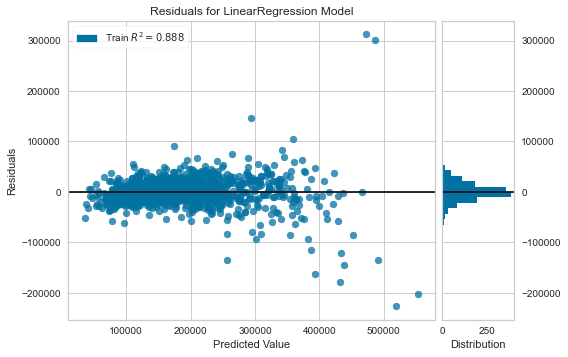

<AxesSubplot:title={'center':'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [44]:
# Instantiate and fit the visualizer to view the residuals within a Linear Regression model
model_dum = LinearRegression()
visualizer_residuals_dum = ResidualsPlot(model_dum)
visualizer_residuals_dum.fit(Xdum, ydum)
visualizer_residuals_dum.show()

### As we can see, there are several outliers of significance, and our initial R^2, even after all of our filtering, is 0.888

C:\Users\gottl\Anaconda3\lib\site-packages\pandas\core\arraylike.py:274: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


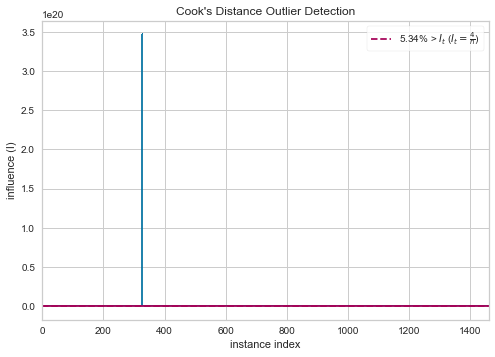

<AxesSubplot:title={'center':"Cook's Distance Outlier Detection"}, xlabel='instance index', ylabel='influence (I)'>

In [45]:
# Visualizing Cook's Distance for the Dummified Dataset
cooks_visualizer_dum = CooksDistance()
cooks_visualizer_dum.fit(Xdum, ydum)
cooks_visualizer_dum.set_title('Cooks Distance for Dummified Dataset')
cooks_visualizer_dum.show()

### There is obviously a very serious outlier present here, as one value is above 350 when most values are less than 0.01. In order to rectify, we can create a filter to only keep observations that are at or below the influence threshold generated by Cook's Distance.

In [46]:
# Cook's Distance helps avoid overly influential datapoints that can bias a predictive dataset. 
# As such, I created a filter to get rid of the observations that would have an outsized influence on the model.
i_less_influential_dum = (cooks_visualizer_dum.distance_ <= cooks_visualizer_dum.influence_threshold_)
Xdum_li, ydum_li = Xdum[i_less_influential_dum].copy(), ydum[i_less_influential_dum].copy()

In [47]:
pd.options.display.max_rows = 20
Xdum_li

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,Remodeled,AgeSinceBuilt,AgeSinceRemodeled,GarageAge,Shed,AlleyGrvl,AlleyPave,BsmtPercFin,TotalHalfBath,TotalFullBath,BsmtTotalBath,GrTotalBath,TotalBath,TotalDeckSpace,TotalLivingArea,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassShared,ClassDuplex,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD,ProxFeedr,ProxArtery,ExtVinylSd,ExtMetalSd,ExtWdSdng,ExtHdBoard,ExtBrkFace,ExtWdShing,ExtCmentBd,ExtPlywood,MasVnrBrkFace,MasVnrStone,FenceGdPrv,FenceGdWo,FenceMnPrv,Fence,MSZoningFV,MSZoningRL,MSZoningRM,LotConfigCorner,LotConfigCulDSac,LotConfigFR2,LotConfigInside,NeighborhoodBrkSide,NeighborhoodCollgCr,NeighborhoodCrawfor,NeighborhoodEdwards,NeighborhoodGilbert,NeighborhoodMitchel,NeighborhoodNAmes,NeighborhoodNWAmes,NeighborhoodNoRidge,NeighborhoodNridgHt,NeighborhoodOldTown,NeighborhoodSawyer,NeighborhoodSawyerW,NeighborhoodSomerst,NeighborhoodTimber,RoofStyleGable,RoofStyleHip,FoundationBrkTil,FoundationCBlock,FoundationPConc,ElectricalFuse,ElectricalSBrkr,GarageTypeAttchd,GarageTypeBuiltIn,GarageTypeDetchd,GarageTypeNone,PavedDriveN,PavedDriveY,SaleTypeCOD,SaleTypeNew,SaleTypeWD,SaleConditionAbnorml,SaleConditionNormal,SaleConditionPartial,FunctionalTyp,FunctionalMin,BsmtFinType1ALQ,BsmtFinType1BLQ,BsmtFinType1GLQ,BsmtFinType1LwQ,BsmtFinType1Rec,BsmtFinType1Unf,BsmtFinType2LwQ,BsmtFinType2None,BsmtFinType2Rec,BsmtFinType2Unf,ExterQualEx,ExterQualGd,ExterQualTA,ExterCondGd,ExterCondTA,BsmtQualEx,BsmtQualGd,BsmtQualTA,BsmtCondFa,BsmtCondGd,BsmtCondTA,HeatingQCEx,HeatingQCFa,HeatingQCGd,HeatingQCTA,KitchenQualEx,KitchenQualFa,KitchenQualGd,KitchenQualTA,FireplaceQuGd,FireplaceQuNone,FireplaceQuTA,GarageQualFa,GarageQualNone,GarageQualTA,GarageCondNone,GarageCondTA,LotShapeIR1,LotShapeIR2,LotShapeReg,LandContourBnk,LandContourHLS,LandContourLvl,BsmtExposureAv,BsmtExposureGd,BsmtExposureMn,BsmtExposureNo,BsmtExposureNone,LandSlopeGtl,LandSlopeMod,GarageFinishFin,GarageFinishNone,GarageFinishRFn,GarageFinishUnf
1,65.0,8450,7,5,2003,2003,706,0,150,856,1,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,2,2008,0,5,5,5.0,0,0,0,82.476636,1,3,1.0,2.5,3.5,61,2566,2416,548,1404,7046,10160,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,196.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,1,0
2,80.0,9600,6,8,1976,1976,978,0,284,1262,1,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,5,2007,0,31,31,31.0,0,0,0,77.496038,1,2,0.5,2.0,2.5,298,2524,2240,460,1722,7878,10862,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0,1,0,0,0,1,0,0,0,1,0
3,68.0,11250,7,5,2001,2002,486,0,434,920,1,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,9,2008,1,7,6,7.0,0,0,0,52.826087,1,3,1.0,2.5,3.5,42,2706,2272,608,1528,9722,13036,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,162.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0
4,60.0,9550,7,5,1915,1970,216,0,540,756,1,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,2,2006,1,91,36,8.0,0,0,0,28.571429,0,2,1.0,1.0,2.0,307,2473,1933,642,1603,7947,11062,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0.0,0.0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,

In [48]:
# How many observations remain of the original 1460 after this filtering?
len(ydum_li)

1380

## Running a Frequency Filter for the square root of the new total number of observations

In [49]:
Xdum_li_lowfilter = round(np.sqrt(len(Xdum_li)))
Xdum_li_highfilter = len(Xdum_li) - Xdum_li_lowfilter

In [50]:
# Finding the features where the number of observed values is below the low frequency filter
manualdroplow_Xdum_li = Xdum_li[Xdum_li.columns[np.where(np.sum(Xdum_li)<Xdum_li_lowfilter)]].sum()

# Finding the features where the number of observed values is above the high frequency filter
manualdrophigh_Xdum_li = Xdum_li[Xdum_li.columns[np.where((np.sum(Xdum_li)>Xdum_li_highfilter) & (np.sum(Xdum_li)<len(Xdum_li)))]].sum()

# Creating a master list of column indices with features that fall within the new filter 
manualdroplist_Xdum_li = list(manualdroplow_Xdum_li.index) + list(manualdrophigh_Xdum_li.index)
manualdroplist_Xdum_li

['AlleyPave',
 'NeighborhoodNoRidge',
 'NeighborhoodTimber',
 'KitchenQualFa',
 'LotShapeIR2']

In [51]:
# Dropping those features from the dataset
Xdum_li.drop(manualdroplist_Xdum_li, axis=1, inplace=True)
Xdum_li

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,Remodeled,AgeSinceBuilt,AgeSinceRemodeled,GarageAge,Shed,AlleyGrvl,BsmtPercFin,TotalHalfBath,TotalFullBath,BsmtTotalBath,GrTotalBath,TotalBath,TotalDeckSpace,TotalLivingArea,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassShared,ClassDuplex,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD,ProxFeedr,ProxArtery,ExtVinylSd,ExtMetalSd,ExtWdSdng,ExtHdBoard,ExtBrkFace,ExtWdShing,ExtCmentBd,ExtPlywood,MasVnrBrkFace,MasVnrStone,FenceGdPrv,FenceGdWo,FenceMnPrv,Fence,MSZoningFV,MSZoningRL,MSZoningRM,LotConfigCorner,LotConfigCulDSac,LotConfigFR2,LotConfigInside,NeighborhoodBrkSide,NeighborhoodCollgCr,NeighborhoodCrawfor,NeighborhoodEdwards,NeighborhoodGilbert,NeighborhoodMitchel,NeighborhoodNAmes,NeighborhoodNWAmes,NeighborhoodNridgHt,NeighborhoodOldTown,NeighborhoodSawyer,NeighborhoodSawyerW,NeighborhoodSomerst,RoofStyleGable,RoofStyleHip,FoundationBrkTil,FoundationCBlock,FoundationPConc,ElectricalFuse,ElectricalSBrkr,GarageTypeAttchd,GarageTypeBuiltIn,GarageTypeDetchd,GarageTypeNone,PavedDriveN,PavedDriveY,SaleTypeCOD,SaleTypeNew,SaleTypeWD,SaleConditionAbnorml,SaleConditionNormal,SaleConditionPartial,FunctionalTyp,FunctionalMin,BsmtFinType1ALQ,BsmtFinType1BLQ,BsmtFinType1GLQ,BsmtFinType1LwQ,BsmtFinType1Rec,BsmtFinType1Unf,BsmtFinType2LwQ,BsmtFinType2None,BsmtFinType2Rec,BsmtFinType2Unf,ExterQualEx,ExterQualGd,ExterQualTA,ExterCondGd,ExterCondTA,BsmtQualEx,BsmtQualGd,BsmtQualTA,BsmtCondFa,BsmtCondGd,BsmtCondTA,HeatingQCEx,HeatingQCFa,HeatingQCGd,HeatingQCTA,KitchenQualEx,KitchenQualGd,KitchenQualTA,FireplaceQuGd,FireplaceQuNone,FireplaceQuTA,GarageQualFa,GarageQualNone,GarageQualTA,GarageCondNone,GarageCondTA,LotShapeIR1,LotShapeReg,LandContourBnk,LandContourHLS,LandContourLvl,BsmtExposureAv,BsmtExposureGd,BsmtExposureMn,BsmtExposureNo,BsmtExposureNone,LandSlopeGtl,LandSlopeMod,GarageFinishFin,GarageFinishNone,GarageFinishRFn,GarageFinishUnf
1,65.0,8450,7,5,2003,2003,706,0,150,856,1,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,2,2008,0,5,5,5.0,0,0,82.476636,1,3,1.0,2.5,3.5,61,2566,2416,548,1404,7046,10160,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,196.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,1,0,0,0,1,1,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,1,0,0,1,0,0,0,1,0,1,0,0,0,1,0
2,80.0,9600,6,8,1976,1976,978,0,284,1262,1,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,5,2007,0,31,31,31.0,0,0,77.496038,1,2,0.5,2.0,2.5,298,2524,2240,460,1722,7878,10862,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,1,0,1,0,0,0,1,0,0,0,1,0
3,68.0,11250,7,5,2001,2002,486,0,434,920,1,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,9,2008,1,7,6,7.0,0,0,52.826087,1,3,1.0,2.5,3.5,42,2706,2272,608,1528,9722,13036,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,162.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,1,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0
4,60.0,9550,7,5,1915,1970,216,0,540,756,1,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,2,2006,1,91,36,8.0,0,0,28.571429,0,2,1.0,1.0,2.0,307,2473,1933,642,1603,7947,11062,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0.0,0.0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,0,1,0,0,1,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,1

## Testing our new dataset with Cook's Distance filtering in place

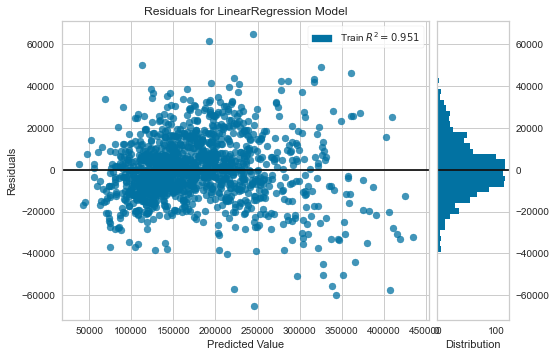

<AxesSubplot:title={'center':'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [52]:
# Instantiate and fit the visualizer to view the residuals of the filtered dataset within a Linear Regression model
bettermodel_dum = LinearRegression()
visualizer_residuals_better_dum = ResidualsPlot(bettermodel_dum)
visualizer_residuals_better_dum.fit(Xdum_li, ydum_li)
visualizer_residuals_better_dum.show()

### As we can see, the distribution appears more Gaussian, and our Train R^2 has improved to a 0.951. This appears to be a far better dataset for generating a predictive model

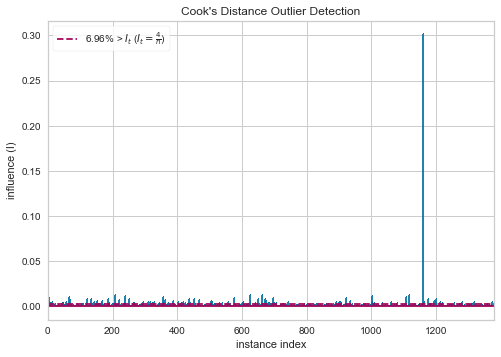

<AxesSubplot:title={'center':"Cook's Distance Outlier Detection"}, xlabel='instance index', ylabel='influence (I)'>

In [53]:
# Visualizing Cook's Distance for the Updated Dummified Dataset
cooks_visualizer_li_better_dum = CooksDistance()
cooks_visualizer_li_better_dum.fit(Xdum_li, ydum_li)
cooks_visualizer_li_better_dum.set_title('Cooks Distance for Dummified Filter Dataset')
cooks_visualizer_li_better_dum.show()

#### We have eliminated our observation with a Cook's Distance of >350, along with 80 others. Now, the most egregious outlier only has a Cook's Distance 0.307, over 1000 times less influential than our previous largest Cook's Distance.

Writing to .csv updated dummified datasets with outliers removed

In [54]:
Xdum_li.to_csv('ames_dummy_data_outliers_removed.csv', header=True)
ydum_li.to_csv('ames_dummy_target_outliers_removed.csv', header=True)

### Can we do even more filtering?
The outlier percentage attribute can help determine how the degree of outliers that remain in a model   
It calculates the percentage of instances whose Cook’s distance is greater than the influence threshold

In [57]:
cooks_visualizer_li_better_dum.outlier_percentage_

6.956521739130435

### In the visualization above, we see one observation feels significantly more influential than others. As the other observations appear to all be relatively uniform, it may make sense to eliminate this one observation to make the dataset more uniform in influence

In [61]:
# Determining the index number of the observation that is over 20 times larger than the next-largest observation
cooks_visualizer_li_better_dum.distance_.sort_values(ascending=False)

1231    3.011531e-01
707     1.287825e-02
219     1.282966e-02
662     1.226172e-02
1185    1.223166e-02
            ...     
939     2.747931e-09
354     2.082232e-09
996     2.009683e-09
687     7.684717e-10
1256    5.958362e-10
Length: 1380, dtype: float64

In [62]:
# Dropping this largest distance / influence observation from the dataset
largest_li_extra_dum = cooks_visualizer_li_better_dum.distance_.sort_values(ascending=False).head(1).index[0]
Xdum_li_drop = Xdum_li.drop(largest_li_extra_dum)
ydum_li_drop = ydum_li.drop(largest_li_extra_dum)

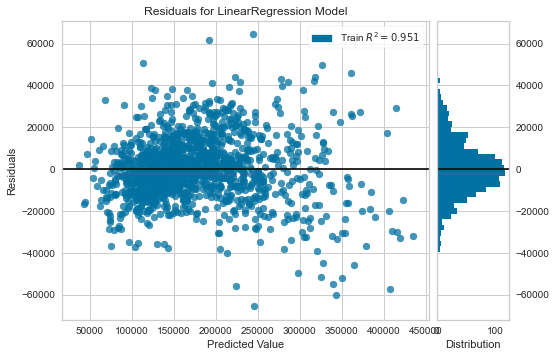

<AxesSubplot:title={'center':'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [63]:
# Instantiate and fit the visualizer to view the residuals of the re-filtered dataset within a Linear Regression model
extramodel_dum = LinearRegression()
visualizer_residuals_extra_dum = ResidualsPlot(extramodel_dum)
visualizer_residuals_extra_dum.fit(Xdum_li_drop, ydum_li_drop)
visualizer_residuals_extra_dum.show()

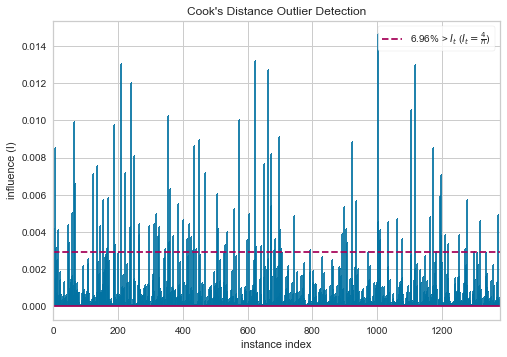

<AxesSubplot:title={'center':"Cook's Distance Outlier Detection"}, xlabel='instance index', ylabel='influence (I)'>

In [64]:
# Visualizing Cook's Distance for the Re-Updated Dummified Dataset
cooks_visualizer_li_extra_dum = CooksDistance()
cooks_visualizer_li_extra_dum.fit(Xdum_li_drop, ydum_li_drop)
cooks_visualizer_li_extra_dum.set_title('Cooks Distance for Dummified Extra-Clean Dataset')
cooks_visualizer_li_extra_dum.show()

### This finally feels uniform!

In [65]:
# Saving and exporting updated datasets with extra cleaned observation to csv
Xdum_li_drop.to_csv('ames_dummy_data_outliers_removed_extra.csv', header=True)
ydum_li_drop.to_csv('ames_dummy_target_outliers_removed_extra.csv', header=True)

## Cook's Distance filtering process for Ordinal Encoding Dataset

- Load the ordinally encoded version of the dataset and separate the target feature (SalePrice) as y
- Instantiate and fit the visualizer to view the residuals within a Linear Regression model

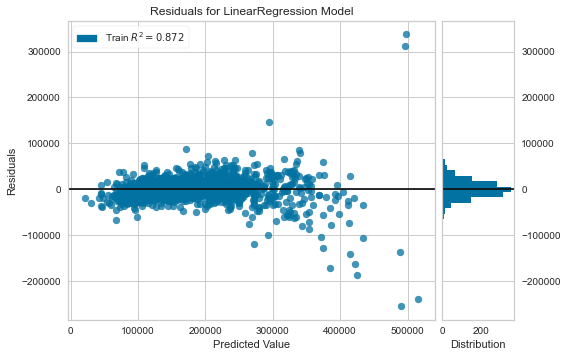

<AxesSubplot:title={'center':'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [66]:
Xord = ames_ord_encode.drop(['SalePrice'], axis=1)
yord = ames_ord_encode.SalePrice

model_ord = LinearRegression()
visualizer_residuals_ord = ResidualsPlot(model_ord)
visualizer_residuals_ord.fit(Xord, yord)
visualizer_residuals_ord.show()

As we can see, there are several outliers of significance, and our initial $R^{2}$, even after all of our filtering, is 0.873 (slightly less than the 0.888 initial $R^{2}$ of the dummified dataset)

C:\Users\gottl\Anaconda3\lib\site-packages\pandas\core\arraylike.py:274: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


CooksDistance(ax=<AxesSubplot:>)

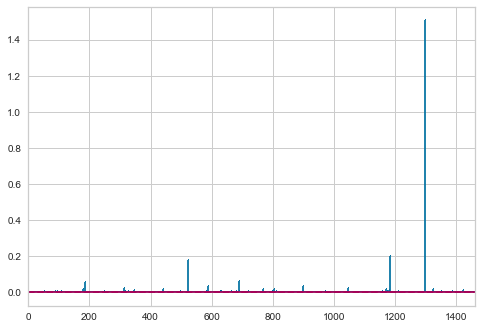

In [67]:
# Visualizing Cook's Distance for the Ordinal Dataset
cooks_visualizer_ord = CooksDistance()
cooks_visualizer_ord.fit(Xord, yord)

### There is a significant outlier present here, although nothing as egregious as the >350 Cook's Distance observation in the dummified dataset. In order to rectify, we can create a filter to only keep observations that are at or below the influence threshold generated by Cook's Distance.

In [68]:
# Cook's Distance helps avoid overly influential datapoints that can bias a predictive dataset. 
# As such, I created a filter to get rid of the observations that would have an outsized influence on the model.
i_less_influential_ord = (cooks_visualizer_ord.distance_ <= cooks_visualizer_ord.influence_threshold_)
Xord_li, yord_li = Xord[i_less_influential_ord].copy(), yord[i_less_influential_ord].copy()

In [69]:
pd.options.display.max_rows = 20
Xord_li

,LotFrontage,LotArea,LotShape,LandContour,Utilities,LandSlope,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,Remodeled,AgeSinceBuilt,AgeSinceRemodeled,GarageAge,Shed,AlleyGrvl,AlleyPave,BsmtPercFin,TotalHalfBath,TotalFullBath,BsmtTotalBath,GrTotalBath,TotalBath,TotalDeckSpace,TotalLivingArea,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassShared,ClassDuplex,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD,ProxFeedr,ProxArtery,ExtVinylSd,ExtMetalSd,ExtWdSdng,ExtHdBoard,ExtBrkFace,ExtWdShing,ExtCmentBd,ExtPlywood,MasVnrBrkFace,MasVnrStone,FenceGdPrv,FenceGdWo,FenceMnPrv,Fence,MSZoningFV,MSZoningRL,MSZoningRM,LotConfigCorner,LotConfigCulDSac,LotConfigFR2,LotConfigInside,NeighborhoodBrkSide,NeighborhoodCollgCr,NeighborhoodCrawfor,NeighborhoodEdwards,NeighborhoodGilbert,NeighborhoodMitchel,NeighborhoodNAmes,NeighborhoodNWAmes,NeighborhoodNoRidge,NeighborhoodNridgHt,NeighborhoodOldTown,NeighborhoodSawyer,NeighborhoodSawyerW,NeighborhoodSomerst,NeighborhoodTimber,RoofStyleGable,RoofStyleHip,FoundationBrkTil,FoundationCBlock,FoundationPConc,ElectricalFuse,ElectricalSBrkr,GarageTypeAttchd,GarageTypeBuiltIn,GarageTypeDetchd,GarageTypeNone,PavedDriveN,PavedDriveY,SaleTypeCOD,SaleTypeNew,SaleTypeWD,SaleConditionAbnorml,SaleConditionNormal,SaleConditionPartial
1,65.0,8450,4.0,4.0,4.0,3.0,7,5,2003,2003,4.0,3.0,4.0,3.0,1.0,6.0,706,1.0,0,150,856,5.0,1,856,854,0,1710,1,0,2,1,3,1,4.0,8,7.0,0,0.0,2003.0,2.0,2,548,3.0,3.0,0,61,0,0,0,0,2,2008,0,5,5,5.0,0,0,0,82.476636,1,3,1.0,2.5,3.5,61,2566,2416,548,1404,7046,10160,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,196.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
2,80.0,9600,4.0,4.0,4.0,3.0,6,8,1976,1976,3.0,3.0,4.0,3.0,4.0,5.0,978,1.0,0,284,1262,5.0,1,1262,0,0,1262,0,1,2,0,3,1,3.0,6,7.0,1,3.0,1976.0,2.0,2,460,3.0,3.0,298,0,0,0,0,0,5,2007,0,31,31,31.0,0,0,0,77.496038,1,2,0.5,2.0,2.5,298,2524,2240,460,1722,7878,10862,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0
3,68.0,11250,3.0,4.0,4.0,3.0,7,5,2001,2002,4.0,3.0,4.0,3.0,2.0,6.0,486,1.0,0,434,920,5.0,1,920,866,0,1786,1,0,2,1,3,1,4.0,6,7.0,1,3.0,2001.0,2.0,2,608,3.0,3.0,0,42,0,0,0,0,9,2008,1,7,6,7.0,0,0,0,52.826087,1,3,1.0,2.5,3.5,42,2706,2272,608,1528,9722,13036,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,162.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
5,84.0,14260,3.0,4.0,4.0,3.0,8,5,2000,2000,4.0,3.0,4.0,3.0,3.0,6.0,655,1.0,0,490,1145,5.0,1,1145,1053,0,2198,1,0,2,1,4,1,4.0,9,7.0,1,3.0,2000.0,2.0,3,836,3.0,3.0,192,84,0,0,0,0,12,2008,0,8,8,8.0,0,0,0,57.205240,1,3,1.0,2.5,3.5,276,3343,2853,836,1981,12279,16458,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,350.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
6,85.0,14115,3.0,4.0,4.0,3.0,5,5,1993,1995,3.0,3.0,4.0,3.0,1.0,6.0,732,1.0,0,64,796,5.0,1,796,566,0,1362,1,0,1,1,1,1,3.0,5,7.0,0,0.0,1993.0,1.0,2,480,3.0,3.0,40,30,0,320,0,0,10,2009,1,16,14,16.0,700,0,0,91.959799,1,2,1.0,1.5,2.5,390,2158,2094,1180,1976,12139,15477,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0.0,0.0,0,0,1,1,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [70]:
# How many observations remain of the original 1460 after this filtering?
len(yord_li)

1392

## Running a Frequency Filter for the square root of the new total number of observations

In [71]:
Xord_lowfilter = round(np.sqrt(len(Xord_li)))
Xord_highfilter = len(Xord_li) - Xord_lowfilter

In [72]:
# Finding the features where the number of observed values is below the low frequency filter
manualdroplow_Xord_li = Xord_li[Xord_li.columns[np.where(np.sum(Xord_li)<Xord_lowfilter)]].sum()

# Finding the features where the number of observed values is above the high frequency filter
manualdrophigh_Xord_li = Xord_li[Xord_li.columns[np.where((np.sum(Xord_li)>Xord_highfilter) & (np.sum(Xord_li)<len(Xord_li)))]].sum()

# Creating a master list of column indices with features that fall within the new filter
manualdroplist_Xord_li = list(manualdroplow_Xord_li.index) + list(manualdrophigh_Xord_li.index)
manualdroplist_Xord_li

['NeighborhoodNoRidge', 'NeighborhoodTimber']

In [73]:
# Dropping those features from the dataset
Xord_li.drop(manualdroplist_Xord_li, axis=1, inplace=True)
Xord_li

,LotFrontage,LotArea,LotShape,LandContour,Utilities,LandSlope,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,Remodeled,AgeSinceBuilt,AgeSinceRemodeled,GarageAge,Shed,AlleyGrvl,AlleyPave,BsmtPercFin,TotalHalfBath,TotalFullBath,BsmtTotalBath,GrTotalBath,TotalBath,TotalDeckSpace,TotalLivingArea,TotalFinLivingArea,TotalGarageShed,FoundationArea,TotalOutdoorSF,TotalSF,Class1hfStr,Class1Str,Class2Str,ClassSplit,ClassSLvl,ClassShared,ClassDuplex,ClassTwnhs,ClassTwnhsI,ClassTwnhsE,Class1Fam,PUD,ProxFeedr,ProxArtery,ExtVinylSd,ExtMetalSd,ExtWdSdng,ExtHdBoard,ExtBrkFace,ExtWdShing,ExtCmentBd,ExtPlywood,MasVnrBrkFace,MasVnrStone,FenceGdPrv,FenceGdWo,FenceMnPrv,Fence,MSZoningFV,MSZoningRL,MSZoningRM,LotConfigCorner,LotConfigCulDSac,LotConfigFR2,LotConfigInside,NeighborhoodBrkSide,NeighborhoodCollgCr,NeighborhoodCrawfor,NeighborhoodEdwards,NeighborhoodGilbert,NeighborhoodMitchel,NeighborhoodNAmes,NeighborhoodNWAmes,NeighborhoodNridgHt,NeighborhoodOldTown,NeighborhoodSawyer,NeighborhoodSawyerW,NeighborhoodSomerst,RoofStyleGable,RoofStyleHip,FoundationBrkTil,FoundationCBlock,FoundationPConc,ElectricalFuse,ElectricalSBrkr,GarageTypeAttchd,GarageTypeBuiltIn,GarageTypeDetchd,GarageTypeNone,PavedDriveN,PavedDriveY,SaleTypeCOD,SaleTypeNew,SaleTypeWD,SaleConditionAbnorml,SaleConditionNormal,SaleConditionPartial
1,65.0,8450,4.0,4.0,4.0,3.0,7,5,2003,2003,4.0,3.0,4.0,3.0,1.0,6.0,706,1.0,0,150,856,5.0,1,856,854,0,1710,1,0,2,1,3,1,4.0,8,7.0,0,0.0,2003.0,2.0,2,548,3.0,3.0,0,61,0,0,0,0,2,2008,0,5,5,5.0,0,0,0,82.476636,1,3,1.0,2.5,3.5,61,2566,2416,548,1404,7046,10160,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,196.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
2,80.0,9600,4.0,4.0,4.0,3.0,6,8,1976,1976,3.0,3.0,4.0,3.0,4.0,5.0,978,1.0,0,284,1262,5.0,1,1262,0,0,1262,0,1,2,0,3,1,3.0,6,7.0,1,3.0,1976.0,2.0,2,460,3.0,3.0,298,0,0,0,0,0,5,2007,0,31,31,31.0,0,0,0,77.496038,1,2,0.5,2.0,2.5,298,2524,2240,460,1722,7878,10862,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0
3,68.0,11250,3.0,4.0,4.0,3.0,7,5,2001,2002,4.0,3.0,4.0,3.0,2.0,6.0,486,1.0,0,434,920,5.0,1,920,866,0,1786,1,0,2,1,3,1,4.0,6,7.0,1,3.0,2001.0,2.0,2,608,3.0,3.0,0,42,0,0,0,0,9,2008,1,7,6,7.0,0,0,0,52.826087,1,3,1.0,2.5,3.5,42,2706,2272,608,1528,9722,13036,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,162.0,0.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
5,84.0,14260,3.0,4.0,4.0,3.0,8,5,2000,2000,4.0,3.0,4.0,3.0,3.0,6.0,655,1.0,0,490,1145,5.0,1,1145,1053,0,2198,1,0,2,1,4,1,4.0,9,7.0,1,3.0,2000.0,2.0,3,836,3.0,3.0,192,84,0,0,0,0,12,2008,0,8,8,8.0,0,0,0,57.205240,1,3,1.0,2.5,3.5,276,3343,2853,836,1981,12279,16458,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,350.0,0.0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0
6,85.0,14115,3.0,4.0,4.0,3.0,5,5,1993,1995,3.0,3.0,4.0,3.0,1.0,6.0,732,1.0,0,64,796,5.0,1,796,566,0,1362,1,0,1,1,1,1,3.0,5,7.0,0,0.0,1993.0,1.0,2,480,3.0,3.0,40,30,0,320,0,0,10,2009,1,16,14,16.0,700,0,0,91.959799,1,2,1.0,1.5,2.5,390,2158,2094,1180,1976,12139,15477,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0.0,0.0,0,0,1,1,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

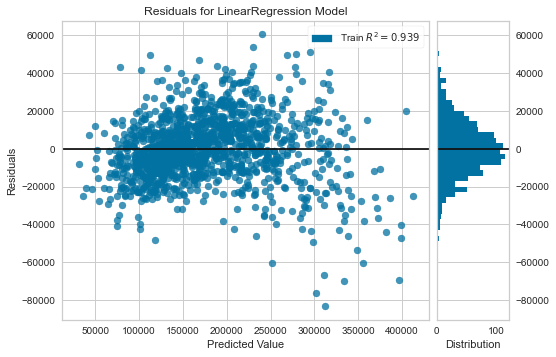

<AxesSubplot:title={'center':'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [74]:
# Instantiate and fit the visualizer to view the residuals of the filtered dataset within a Linear Regression model
bettermodel_ord = LinearRegression()
visualizer_residuals_better_ord = ResidualsPlot(bettermodel_ord)
visualizer_residuals_better_ord.fit(Xord_li, yord_li)
visualizer_residuals_better_ord.show()

### As we can see, the distribution appears more Gaussian, and our Train R^2 has improved to a 0.941. This appears to be a far better dataset for generating a predictive model, although it is below the R^2 of 0.951 found in the filtered dummified dataset

C:\Users\gottl\Anaconda3\lib\site-packages\pandas\core\arraylike.py:274: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


CooksDistance(ax=<AxesSubplot:>)

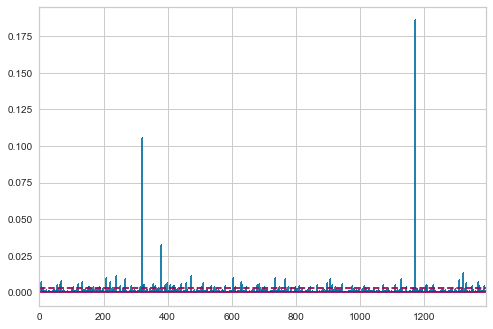

In [75]:
# Visualizing Cook's Distance for the Updated Ordinally Encoded Dataset
cooks_visualizer_li_better_ord = CooksDistance()
cooks_visualizer_li_better_ord.fit(Xord_li, yord_li)

### We have eliminated 68 observations, and now the most egregious outlier only has a Cook's Distance 0.330

In [76]:
# Saving and exporting updated ordinally encoded datasets to csv
Xord_li.to_csv('ames_ord_data_outliers_removed.csv', header=True)
yord_li.to_csv('ames_ord_target_outliers_removed.csv', header=True)

## Can we do even more filtering?

In [77]:
# The outlier percentage attribute can help determine how the degree of outliers that remain in a model.
# It calculates the percentage of instances whose Cook’s distance is greater than the influence threshold
cooks_visualizer_li_better_ord.outlier_percentage_

6.25

### In the visualization above, we see that two observations feel significantly more influential than the others. As the other observations appear to all be relatively uniform, it may make sense to eliminate these two observations to make the dataset more uniform in influence

In [78]:
# Determining the index number of the top two observations that are 28 times and 17 times larger 
# than the third-largest observation
cooks_visualizer_li_better_ord.distance_.sort_values(ascending=False)

1231    1.859068e-01
336     1.054243e-01
399     3.204807e-02
1389    1.331302e-02
496     1.120240e-02
            ...     
1149    6.089622e-08
23      4.598301e-08
60      3.308012e-08
1096    1.666575e-08
683              NaN
Length: 1392, dtype: float64

In [79]:
# Dropping the two largest distance / influence observations from the dataset
largest_li_extra_ord = cooks_visualizer_li_better_ord.distance_.sort_values(ascending=False).head(1).index[0]
second_largest_li_extra_ord = cooks_visualizer_li_better_ord.distance_.sort_values(ascending=False).head(2).index[1]
Xord_li_drop = Xord_li.drop([largest_li_extra_ord, second_largest_li_extra_ord])
yord_li_drop = yord_li.drop([largest_li_extra_ord, second_largest_li_extra_ord])

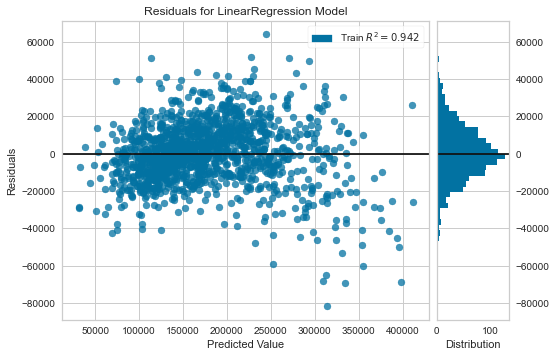

<AxesSubplot:title={'center':'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [80]:
# Instantiate and fit the visualizer to view the residuals of the re-filtered dataset within a Linear Regression model
extramodel_ord = LinearRegression()
visualizer_residuals_extra_ord = ResidualsPlot(extramodel_ord)
visualizer_residuals_extra_ord.fit(Xord_li_drop, yord_li_drop)
visualizer_residuals_extra_ord.show()

C:\Users\gottl\Anaconda3\lib\site-packages\pandas\core\arraylike.py:274: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


CooksDistance(ax=<AxesSubplot:>)

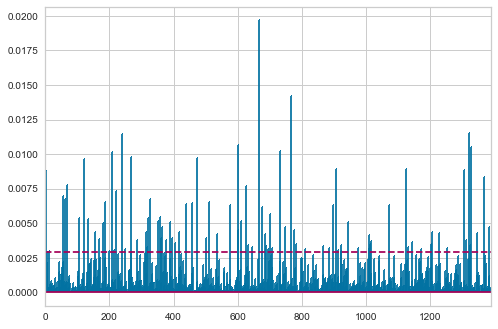

In [81]:
# Visualizing Cook's Distance for the Re-Updated Ordinally Encoded Dataset
cooks_visualizer_li_extra_ord = CooksDistance()
cooks_visualizer_li_extra_ord.fit(Xord_li_drop, yord_li_drop)

### This finally feels uniform!

In [82]:
# Saving and exporting updated datasets with extra cleaned observation to csv
Xord_li_drop.to_csv('ames_ord_data_outliers_removed_extra.csv', header=True)
yord_li_drop.to_csv('ames_ord_target_outliers_removed_extra.csv', header=True)

# Six ML-Ready Datasets
[Back to Top](#Pre-Processing-Ames-Housing-Data)
I have now cleaned, filtered, and transformed the Ames Dataset into 6 potential Machine-Learning-ready versions.
**For both the Ordinally Encoded and Fully Dummified versions, I now have a version with:**
- No Cook's Distance filtering (Xord or Xdum)
- Cook's Distance filtering (Xord_filter, Xdum_filter)
- Cook's Distance filtering plus extra outliers manually removed (Xord_clean, Xdum_clean)